<a href="https://colab.research.google.com/github/bttrung/cheat-sheet/blob/master/project_tshirt.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

In [0]:
# import resources
%matplotlib inline

from PIL import Image
from io import BytesIO
import matplotlib.pyplot as plt
import numpy as np

import torch
import torch.optim as optim
import requests
from torchvision import transforms, models

In [3]:
# get the "features" portion of VGG19 (we will not need the "classifier" portion)
vgg = models.vgg19(pretrained=True).features

# freeze all VGG parameters since we're only optimizing the target image
for param in vgg.parameters():
    param.requires_grad_(False)

Downloading: "https://download.pytorch.org/models/vgg19-dcbb9e9d.pth" to /root/.cache/torch/checkpoints/vgg19-dcbb9e9d.pth
100%|██████████| 574673361/574673361 [00:11<00:00, 49437587.19it/s]


In [4]:
# move the model to GPU, if available
device = torch.device("cuda" if torch.cuda.is_available() else "cpu")

vgg.to(device)

Sequential(
  (0): Conv2d(3, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
  (1): ReLU(inplace)
  (2): Conv2d(64, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
  (3): ReLU(inplace)
  (4): MaxPool2d(kernel_size=2, stride=2, padding=0, dilation=1, ceil_mode=False)
  (5): Conv2d(64, 128, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
  (6): ReLU(inplace)
  (7): Conv2d(128, 128, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
  (8): ReLU(inplace)
  (9): MaxPool2d(kernel_size=2, stride=2, padding=0, dilation=1, ceil_mode=False)
  (10): Conv2d(128, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
  (11): ReLU(inplace)
  (12): Conv2d(256, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
  (13): ReLU(inplace)
  (14): Conv2d(256, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
  (15): ReLU(inplace)
  (16): Conv2d(256, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
  (17): ReLU(inplace)
  (18): MaxPool2d(kernel_size=2, stride=2, padding=0, 

In [0]:
def load_image(img_path, max_size=400, shape=None):
    ''' Load in and transform an image, making sure the image
       is <= 400 pixels in the x-y dims.'''
    if "http" in img_path:
        response = requests.get(img_path)
        image = Image.open(BytesIO(response.content)).convert('RGB')
    else:
        image = Image.open(img_path).convert('RGB')
    
    # large images will slow down processing
    if max(image.size) > max_size:
        size = max_size
    else:
        size = max(image.size)
    
    if shape is not None:
        size = shape
        
    in_transform = transforms.Compose([
                        transforms.Resize(size),
                        transforms.ToTensor(),
                        transforms.Normalize((0.485, 0.456, 0.406), 
                                             (0.229, 0.224, 0.225))])

    # discard the transparent, alpha channel (that's the :3) and add the batch dimension
    image = in_transform(image)[:3,:,:].unsqueeze(0)
    
    return image

In [0]:
# load in content and style image
content = load_image('dog.jpg').to(device)
# Resize style to match content, makes code easier
style = load_image('dog-style.jpg', shape=content.shape[-2:]).to(device)

In [0]:
# helper function for un-normalizing an image 
# and converting it from a Tensor image to a NumPy image for display
def im_convert(tensor):
    """ Display a tensor as an image. """
    
    image = tensor.to("cpu").clone().detach()
    image = image.numpy().squeeze()
    image = image.transpose(1,2,0)
    image = image * np.array((0.229, 0.224, 0.225)) + np.array((0.485, 0.456, 0.406))
    image = image.clip(0, 1)

    return image

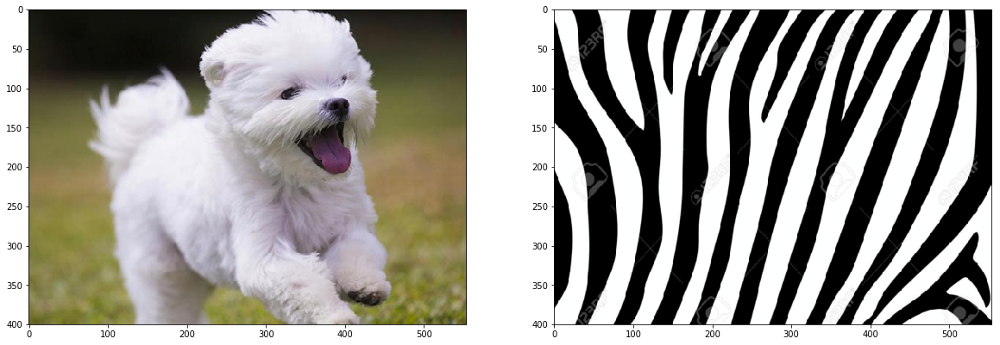

In [17]:
# display the images
fig, (ax1, ax2) = plt.subplots(1, 2, figsize=(20, 10))
# content and style ims side-by-side
ax1.imshow(im_convert(content))
ax2.imshow(im_convert(style))

In [0]:
print(vgg)

Sequential(
  (0): Conv2d(3, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
  (1): ReLU(inplace)
  (2): Conv2d(64, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
  (3): ReLU(inplace)
  (4): MaxPool2d(kernel_size=2, stride=2, padding=0, dilation=1, ceil_mode=False)
  (5): Conv2d(64, 128, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
  (6): ReLU(inplace)
  (7): Conv2d(128, 128, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
  (8): ReLU(inplace)
  (9): MaxPool2d(kernel_size=2, stride=2, padding=0, dilation=1, ceil_mode=False)
  (10): Conv2d(128, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
  (11): ReLU(inplace)
  (12): Conv2d(256, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
  (13): ReLU(inplace)
  (14): Conv2d(256, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
  (15): ReLU(inplace)
  (16): Conv2d(256, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
  (17): ReLU(inplace)
  (18): MaxPool2d(kernel_size=2, stride=2, padding=0, 

In [0]:
def get_features(image, model, layers=None):
    """ Run an image forward through a model and get the features for 
        a set of layers. Default layers are for VGGNet matching Gatys et al (2016)
    """
    
    ## TODO: Complete mapping layer names of PyTorch's VGGNet to names from the paper
    ## Need the layers for the content and style representations of an image
    if layers is None:
        layers = {'0': 'conv1_1',
                  '5': 'conv2_1', 
                  '10': 'conv3_1', 
                  '19': 'conv4_1',
                  '21': 'conv4_2',  ## content representation
                  '28': 'conv5_1'}
        
    features = {}
    x = image
    # model._modules is a dictionary holding each module in the model
    for name, layer in model._modules.items():
        x = layer(x)
        if name in layers:
            features[layers[name]] = x
            
    return features

In [0]:
def gram_matrix(tensor):
    """ Calculate the Gram Matrix of a given tensor 
        Gram Matrix: https://en.wikipedia.org/wiki/Gramian_matrix
    """
    
    # get the batch_size, depth, height, and width of the Tensor
    _, d, h, w = tensor.size()
    
    # reshape so we're multiplying the features for each channel
    tensor = tensor.view(d, h * w)
    
    # calculate the gram matrix
    gram = torch.mm(tensor, tensor.t())
    
    return gram

In [0]:
# get content and style features only once before training
content_features = get_features(content, vgg)
style_features = get_features(style, vgg)

# calculate the gram matrices for each layer of our style representation
style_grams = {layer: gram_matrix(style_features[layer]) for layer in style_features}

# create a third "target" image and prep it for change
# it is a good idea to start off with the target as a copy of our *content* image
# then iteratively change its style
target = content.clone().requires_grad_(True).to(device)

In [0]:

# weights for each style layer 
# weighting earlier layers more will result in *larger* style artifacts
# notice we are excluding `conv4_2` our content representation
style_weights = {'conv1_1': 1.,
                 'conv2_1': 0.75,
                 'conv3_1': 0.2,
                 'conv4_1': 0.2,
                 'conv5_1': 0.2}

content_weight = 1  # alpha
style_weight = 1e6  # beta

Step ... 1
Step ... 2
Step ... 3
Step ... 4
Step ... 5
Step ... 6
Step ... 7
Step ... 8
Step ... 9
Step ... 10
Step ... 11
Step ... 12
Step ... 13
Step ... 14
Step ... 15
Step ... 16
Step ... 17
Step ... 18
Step ... 19
Step ... 20
Step ... 21
Step ... 22
Step ... 23
Step ... 24
Step ... 25
Step ... 26
Step ... 27
Step ... 28
Step ... 29
Step ... 30
Total loss:  2874991360.0


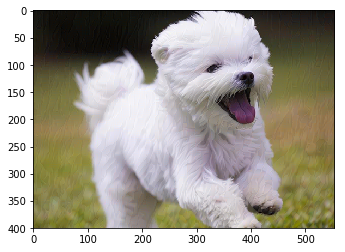

Step ... 31
Step ... 32
Step ... 33
Step ... 34
Step ... 35
Step ... 36
Step ... 37
Step ... 38
Step ... 39
Step ... 40
Step ... 41
Step ... 42
Step ... 43
Step ... 44
Step ... 45
Step ... 46
Step ... 47
Step ... 48
Step ... 49
Step ... 50
Step ... 51
Step ... 52
Step ... 53
Step ... 54
Step ... 55
Step ... 56
Step ... 57
Step ... 58
Step ... 59
Step ... 60
Total loss:  2418907392.0


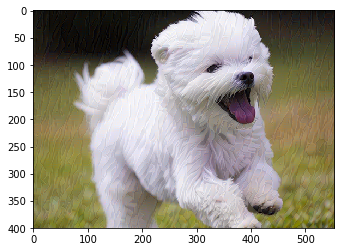

Step ... 61
Step ... 62
Step ... 63
Step ... 64
Step ... 65
Step ... 66
Step ... 67
Step ... 68
Step ... 69
Step ... 70
Step ... 71
Step ... 72
Step ... 73
Step ... 74
Step ... 75
Step ... 76
Step ... 77
Step ... 78
Step ... 79
Step ... 80
Step ... 81
Step ... 82
Step ... 83
Step ... 84
Step ... 85
Step ... 86
Step ... 87
Step ... 88
Step ... 89
Step ... 90
Total loss:  2146259968.0


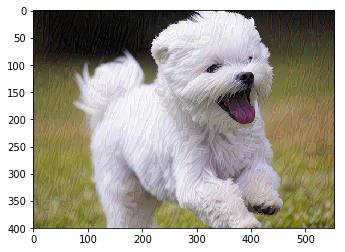

Step ... 91
Step ... 92
Step ... 93
Step ... 94
Step ... 95
Step ... 96
Step ... 97
Step ... 98
Step ... 99
Step ... 100
Step ... 101
Step ... 102
Step ... 103
Step ... 104
Step ... 105
Step ... 106
Step ... 107
Step ... 108
Step ... 109
Step ... 110
Step ... 111
Step ... 112
Step ... 113
Step ... 114
Step ... 115
Step ... 116
Step ... 117
Step ... 118
Step ... 119
Step ... 120
Total loss:  1949839360.0


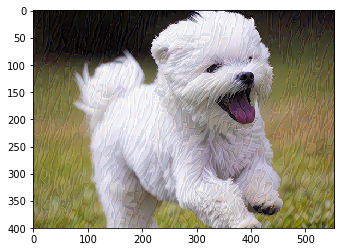

Step ... 121
Step ... 122
Step ... 123
Step ... 124
Step ... 125
Step ... 126
Step ... 127
Step ... 128
Step ... 129
Step ... 130
Step ... 131
Step ... 132
Step ... 133
Step ... 134
Step ... 135
Step ... 136
Step ... 137
Step ... 138
Step ... 139
Step ... 140
Step ... 141
Step ... 142
Step ... 143
Step ... 144
Step ... 145
Step ... 146
Step ... 147
Step ... 148
Step ... 149
Step ... 150
Total loss:  1788627200.0


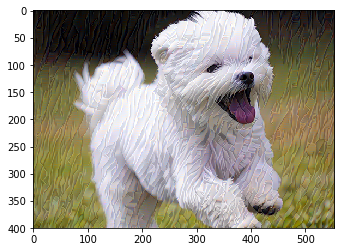

Step ... 151
Step ... 152
Step ... 153
Step ... 154
Step ... 155
Step ... 156
Step ... 157
Step ... 158
Step ... 159
Step ... 160
Step ... 161
Step ... 162
Step ... 163
Step ... 164
Step ... 165
Step ... 166
Step ... 167
Step ... 168
Step ... 169
Step ... 170
Step ... 171
Step ... 172
Step ... 173
Step ... 174
Step ... 175
Step ... 176
Step ... 177
Step ... 178
Step ... 179
Step ... 180
Total loss:  1646342016.0


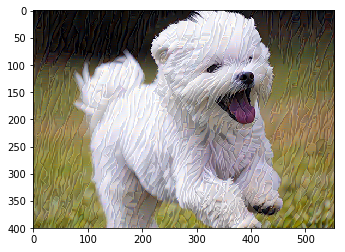

Step ... 181
Step ... 182
Step ... 183
Step ... 184
Step ... 185
Step ... 186
Step ... 187
Step ... 188
Step ... 189
Step ... 190
Step ... 191
Step ... 192
Step ... 193
Step ... 194
Step ... 195
Step ... 196
Step ... 197
Step ... 198
Step ... 199
Step ... 200
Step ... 201
Step ... 202
Step ... 203
Step ... 204
Step ... 205
Step ... 206
Step ... 207
Step ... 208
Step ... 209
Step ... 210
Total loss:  1516897920.0


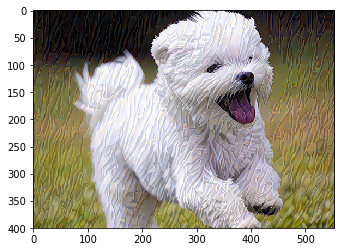

Step ... 211
Step ... 212
Step ... 213
Step ... 214
Step ... 215
Step ... 216
Step ... 217
Step ... 218
Step ... 219
Step ... 220
Step ... 221
Step ... 222
Step ... 223
Step ... 224
Step ... 225
Step ... 226
Step ... 227
Step ... 228
Step ... 229
Step ... 230
Step ... 231
Step ... 232
Step ... 233
Step ... 234
Step ... 235
Step ... 236
Step ... 237
Step ... 238
Step ... 239
Step ... 240
Total loss:  1397330432.0


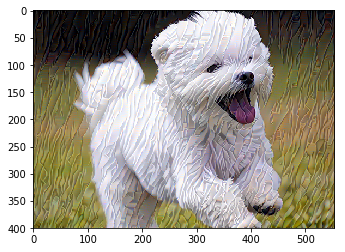

Step ... 241
Step ... 242
Step ... 243
Step ... 244
Step ... 245
Step ... 246
Step ... 247
Step ... 248
Step ... 249
Step ... 250
Step ... 251
Step ... 252
Step ... 253
Step ... 254
Step ... 255
Step ... 256
Step ... 257
Step ... 258
Step ... 259
Step ... 260
Step ... 261
Step ... 262
Step ... 263
Step ... 264
Step ... 265
Step ... 266
Step ... 267
Step ... 268
Step ... 269
Step ... 270
Total loss:  1286471936.0


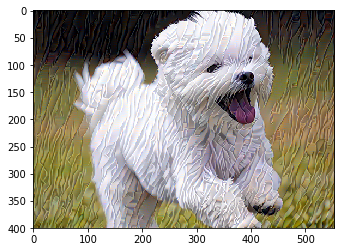

Step ... 271
Step ... 272
Step ... 273
Step ... 274
Step ... 275
Step ... 276
Step ... 277
Step ... 278
Step ... 279
Step ... 280
Step ... 281
Step ... 282
Step ... 283
Step ... 284
Step ... 285
Step ... 286
Step ... 287
Step ... 288
Step ... 289
Step ... 290
Step ... 291
Step ... 292
Step ... 293
Step ... 294
Step ... 295
Step ... 296
Step ... 297
Step ... 298
Step ... 299
Step ... 300
Total loss:  1184370048.0


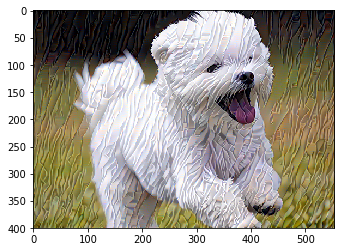

Step ... 301
Step ... 302
Step ... 303
Step ... 304
Step ... 305
Step ... 306
Step ... 307
Step ... 308
Step ... 309
Step ... 310
Step ... 311
Step ... 312
Step ... 313
Step ... 314
Step ... 315
Step ... 316
Step ... 317
Step ... 318
Step ... 319
Step ... 320
Step ... 321
Step ... 322
Step ... 323
Step ... 324
Step ... 325
Step ... 326
Step ... 327
Step ... 328
Step ... 329
Step ... 330
Total loss:  1091214848.0


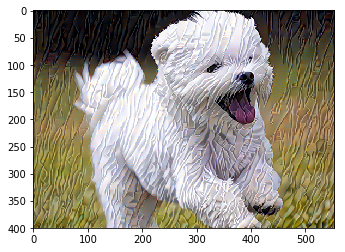

Step ... 331
Step ... 332
Step ... 333
Step ... 334
Step ... 335
Step ... 336
Step ... 337
Step ... 338
Step ... 339
Step ... 340
Step ... 341
Step ... 342
Step ... 343
Step ... 344
Step ... 345
Step ... 346
Step ... 347
Step ... 348
Step ... 349
Step ... 350
Step ... 351
Step ... 352
Step ... 353
Step ... 354
Step ... 355
Step ... 356
Step ... 357
Step ... 358
Step ... 359
Step ... 360
Total loss:  1007459072.0


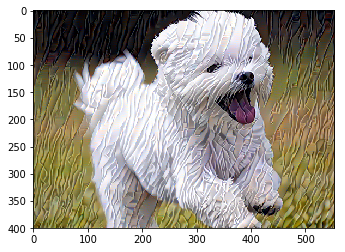

Step ... 361
Step ... 362
Step ... 363
Step ... 364
Step ... 365
Step ... 366
Step ... 367
Step ... 368
Step ... 369
Step ... 370
Step ... 371
Step ... 372
Step ... 373
Step ... 374
Step ... 375
Step ... 376
Step ... 377
Step ... 378
Step ... 379
Step ... 380
Step ... 381
Step ... 382
Step ... 383
Step ... 384
Step ... 385
Step ... 386
Step ... 387
Step ... 388
Step ... 389
Step ... 390
Total loss:  933393920.0


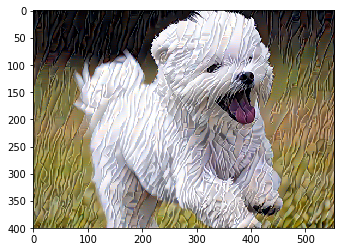

Step ... 391
Step ... 392
Step ... 393
Step ... 394
Step ... 395
Step ... 396
Step ... 397
Step ... 398
Step ... 399
Step ... 400
Step ... 401
Step ... 402
Step ... 403
Step ... 404
Step ... 405
Step ... 406
Step ... 407
Step ... 408
Step ... 409
Step ... 410
Step ... 411
Step ... 412
Step ... 413
Step ... 414
Step ... 415
Step ... 416
Step ... 417
Step ... 418
Step ... 419
Step ... 420
Total loss:  869030912.0


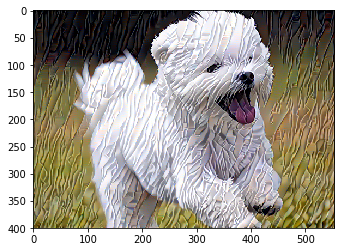

Step ... 421
Step ... 422
Step ... 423
Step ... 424
Step ... 425
Step ... 426
Step ... 427
Step ... 428
Step ... 429
Step ... 430
Step ... 431
Step ... 432
Step ... 433
Step ... 434
Step ... 435
Step ... 436
Step ... 437
Step ... 438
Step ... 439
Step ... 440
Step ... 441
Step ... 442
Step ... 443
Step ... 444
Step ... 445
Step ... 446
Step ... 447
Step ... 448
Step ... 449
Step ... 450
Total loss:  813761728.0


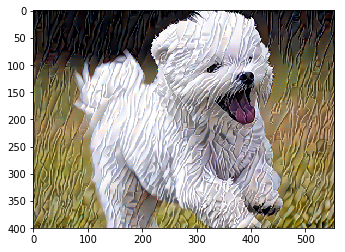

Step ... 451
Step ... 452
Step ... 453
Step ... 454
Step ... 455
Step ... 456
Step ... 457
Step ... 458
Step ... 459
Step ... 460
Step ... 461
Step ... 462
Step ... 463
Step ... 464
Step ... 465
Step ... 466
Step ... 467
Step ... 468
Step ... 469
Step ... 470
Step ... 471
Step ... 472
Step ... 473
Step ... 474
Step ... 475
Step ... 476
Step ... 477
Step ... 478
Step ... 479
Step ... 480
Total loss:  766763520.0


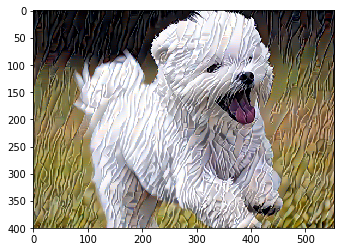

Step ... 481
Step ... 482
Step ... 483
Step ... 484
Step ... 485
Step ... 486
Step ... 487
Step ... 488
Step ... 489
Step ... 490
Step ... 491
Step ... 492
Step ... 493
Step ... 494
Step ... 495
Step ... 496
Step ... 497
Step ... 498
Step ... 499
Step ... 500
Step ... 501
Step ... 502
Step ... 503
Step ... 504
Step ... 505
Step ... 506
Step ... 507
Step ... 508
Step ... 509
Step ... 510
Total loss:  727011328.0


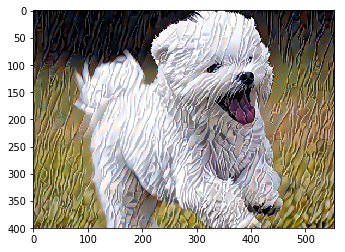

Step ... 511
Step ... 512
Step ... 513
Step ... 514
Step ... 515
Step ... 516
Step ... 517
Step ... 518
Step ... 519
Step ... 520
Step ... 521
Step ... 522
Step ... 523
Step ... 524
Step ... 525
Step ... 526
Step ... 527
Step ... 528
Step ... 529
Step ... 530
Step ... 531
Step ... 532
Step ... 533
Step ... 534
Step ... 535
Step ... 536
Step ... 537
Step ... 538
Step ... 539
Step ... 540
Total loss:  693245504.0


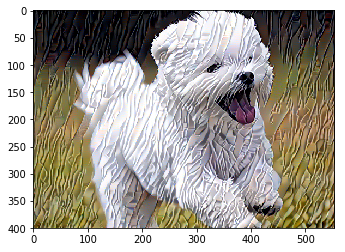

Step ... 541
Step ... 542
Step ... 543
Step ... 544
Step ... 545
Step ... 546
Step ... 547
Step ... 548
Step ... 549
Step ... 550
Step ... 551
Step ... 552
Step ... 553
Step ... 554
Step ... 555
Step ... 556
Step ... 557
Step ... 558
Step ... 559
Step ... 560
Step ... 561
Step ... 562
Step ... 563
Step ... 564
Step ... 565
Step ... 566
Step ... 567
Step ... 568
Step ... 569
Step ... 570
Total loss:  664444864.0


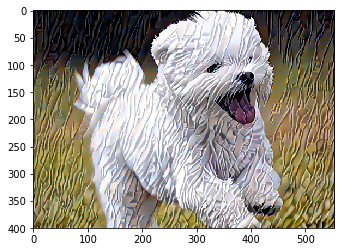

Step ... 571
Step ... 572
Step ... 573
Step ... 574
Step ... 575
Step ... 576
Step ... 577
Step ... 578
Step ... 579
Step ... 580
Step ... 581
Step ... 582
Step ... 583
Step ... 584
Step ... 585
Step ... 586
Step ... 587
Step ... 588
Step ... 589
Step ... 590
Step ... 591
Step ... 592
Step ... 593
Step ... 594
Step ... 595
Step ... 596
Step ... 597
Step ... 598
Step ... 599
Step ... 600
Total loss:  639677056.0


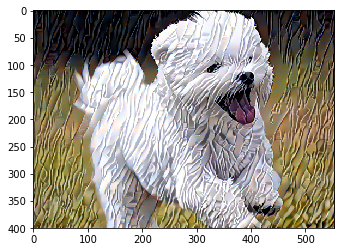

Step ... 601
Step ... 602
Step ... 603
Step ... 604
Step ... 605
Step ... 606
Step ... 607
Step ... 608
Step ... 609
Step ... 610
Step ... 611
Step ... 612
Step ... 613
Step ... 614
Step ... 615
Step ... 616
Step ... 617
Step ... 618
Step ... 619
Step ... 620
Step ... 621
Step ... 622
Step ... 623
Step ... 624
Step ... 625
Step ... 626
Step ... 627
Step ... 628
Step ... 629
Step ... 630
Total loss:  618069952.0


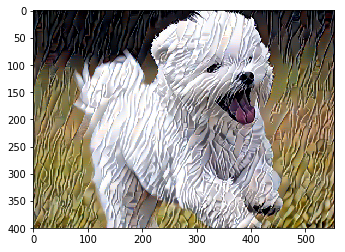

Step ... 631
Step ... 632
Step ... 633
Step ... 634
Step ... 635
Step ... 636
Step ... 637
Step ... 638
Step ... 639
Step ... 640
Step ... 641
Step ... 642
Step ... 643
Step ... 644
Step ... 645
Step ... 646
Step ... 647
Step ... 648
Step ... 649
Step ... 650
Step ... 651
Step ... 652
Step ... 653
Step ... 654
Step ... 655
Step ... 656
Step ... 657
Step ... 658
Step ... 659
Step ... 660
Total loss:  598942016.0


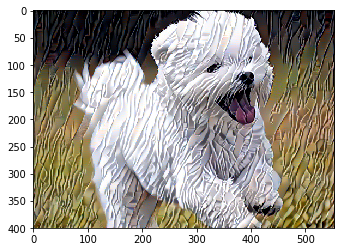

Step ... 661
Step ... 662
Step ... 663
Step ... 664
Step ... 665
Step ... 666
Step ... 667
Step ... 668
Step ... 669
Step ... 670
Step ... 671
Step ... 672
Step ... 673
Step ... 674
Step ... 675
Step ... 676
Step ... 677
Step ... 678
Step ... 679
Step ... 680
Step ... 681
Step ... 682
Step ... 683
Step ... 684
Step ... 685
Step ... 686
Step ... 687
Step ... 688
Step ... 689
Step ... 690
Total loss:  581777344.0


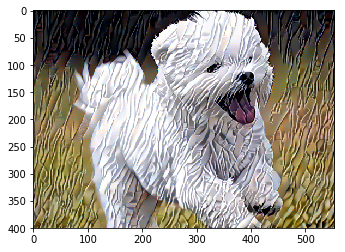

Step ... 691
Step ... 692
Step ... 693
Step ... 694
Step ... 695
Step ... 696
Step ... 697
Step ... 698
Step ... 699
Step ... 700
Step ... 701
Step ... 702
Step ... 703
Step ... 704
Step ... 705
Step ... 706
Step ... 707
Step ... 708
Step ... 709
Step ... 710
Step ... 711
Step ... 712
Step ... 713
Step ... 714
Step ... 715
Step ... 716
Step ... 717
Step ... 718
Step ... 719
Step ... 720
Total loss:  566247552.0


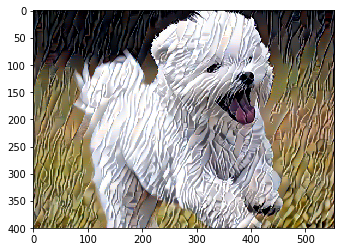

Step ... 721
Step ... 722
Step ... 723
Step ... 724
Step ... 725
Step ... 726
Step ... 727
Step ... 728
Step ... 729
Step ... 730
Step ... 731
Step ... 732
Step ... 733
Step ... 734
Step ... 735
Step ... 736
Step ... 737
Step ... 738
Step ... 739
Step ... 740
Step ... 741
Step ... 742
Step ... 743
Step ... 744
Step ... 745
Step ... 746
Step ... 747
Step ... 748
Step ... 749
Step ... 750
Total loss:  551990336.0


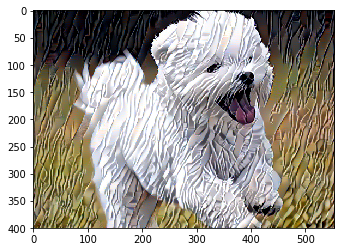

Step ... 751
Step ... 752
Step ... 753
Step ... 754
Step ... 755
Step ... 756
Step ... 757
Step ... 758
Step ... 759
Step ... 760
Step ... 761
Step ... 762
Step ... 763
Step ... 764
Step ... 765
Step ... 766
Step ... 767
Step ... 768
Step ... 769
Step ... 770
Step ... 771
Step ... 772
Step ... 773
Step ... 774
Step ... 775
Step ... 776
Step ... 777
Step ... 778
Step ... 779
Step ... 780
Total loss:  538793152.0


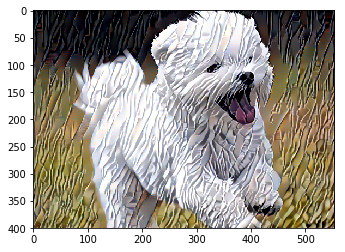

Step ... 781
Step ... 782
Step ... 783
Step ... 784
Step ... 785
Step ... 786
Step ... 787
Step ... 788
Step ... 789
Step ... 790
Step ... 791
Step ... 792
Step ... 793
Step ... 794
Step ... 795
Step ... 796
Step ... 797
Step ... 798
Step ... 799
Step ... 800
Step ... 801
Step ... 802
Step ... 803
Step ... 804
Step ... 805
Step ... 806
Step ... 807
Step ... 808
Step ... 809
Step ... 810
Total loss:  526470624.0


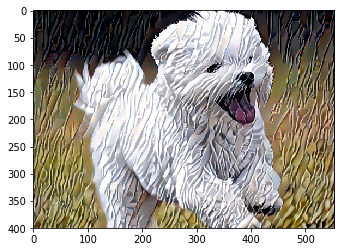

Step ... 811
Step ... 812
Step ... 813
Step ... 814
Step ... 815
Step ... 816
Step ... 817
Step ... 818
Step ... 819
Step ... 820
Step ... 821
Step ... 822
Step ... 823
Step ... 824
Step ... 825
Step ... 826
Step ... 827
Step ... 828
Step ... 829
Step ... 830
Step ... 831
Step ... 832
Step ... 833
Step ... 834
Step ... 835
Step ... 836
Step ... 837
Step ... 838
Step ... 839
Step ... 840
Total loss:  514868512.0


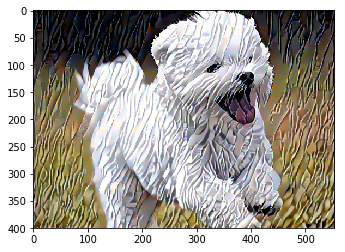

Step ... 841
Step ... 842
Step ... 843
Step ... 844
Step ... 845
Step ... 846
Step ... 847
Step ... 848
Step ... 849
Step ... 850
Step ... 851
Step ... 852
Step ... 853
Step ... 854
Step ... 855
Step ... 856
Step ... 857
Step ... 858
Step ... 859
Step ... 860
Step ... 861
Step ... 862
Step ... 863
Step ... 864
Step ... 865
Step ... 866
Step ... 867
Step ... 868
Step ... 869
Step ... 870
Total loss:  503895616.0


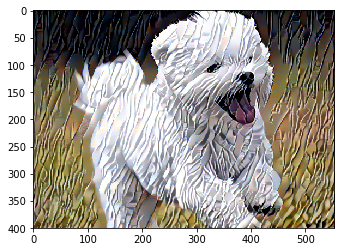

Step ... 871
Step ... 872
Step ... 873
Step ... 874
Step ... 875
Step ... 876
Step ... 877
Step ... 878
Step ... 879
Step ... 880
Step ... 881
Step ... 882
Step ... 883
Step ... 884
Step ... 885
Step ... 886
Step ... 887
Step ... 888
Step ... 889
Step ... 890
Step ... 891
Step ... 892
Step ... 893
Step ... 894
Step ... 895
Step ... 896
Step ... 897
Step ... 898
Step ... 899
Step ... 900
Total loss:  493476032.0


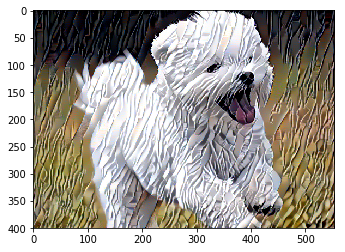

Step ... 901
Step ... 902
Step ... 903
Step ... 904
Step ... 905
Step ... 906
Step ... 907
Step ... 908
Step ... 909
Step ... 910
Step ... 911
Step ... 912
Step ... 913
Step ... 914
Step ... 915
Step ... 916
Step ... 917
Step ... 918
Step ... 919
Step ... 920
Step ... 921
Step ... 922
Step ... 923
Step ... 924
Step ... 925
Step ... 926
Step ... 927
Step ... 928
Step ... 929
Step ... 930
Total loss:  483548960.0


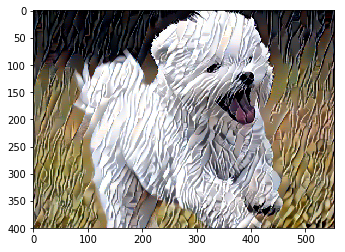

Step ... 931
Step ... 932
Step ... 933
Step ... 934
Step ... 935
Step ... 936
Step ... 937
Step ... 938
Step ... 939
Step ... 940
Step ... 941
Step ... 942
Step ... 943
Step ... 944
Step ... 945
Step ... 946
Step ... 947
Step ... 948
Step ... 949
Step ... 950
Step ... 951
Step ... 952
Step ... 953
Step ... 954
Step ... 955
Step ... 956
Step ... 957
Step ... 958
Step ... 959
Step ... 960
Total loss:  474022656.0


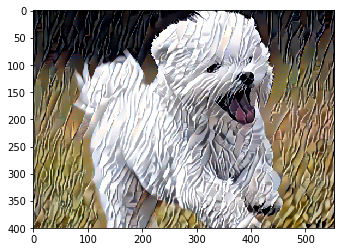

Step ... 961
Step ... 962
Step ... 963
Step ... 964
Step ... 965
Step ... 966
Step ... 967
Step ... 968
Step ... 969
Step ... 970
Step ... 971
Step ... 972
Step ... 973
Step ... 974
Step ... 975
Step ... 976
Step ... 977
Step ... 978
Step ... 979
Step ... 980
Step ... 981
Step ... 982
Step ... 983
Step ... 984
Step ... 985
Step ... 986
Step ... 987
Step ... 988
Step ... 989
Step ... 990
Total loss:  464837088.0


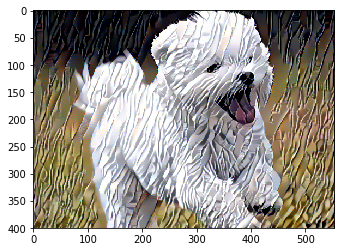

Step ... 991
Step ... 992
Step ... 993
Step ... 994
Step ... 995
Step ... 996
Step ... 997
Step ... 998
Step ... 999
Step ... 1000
Step ... 1001
Step ... 1002
Step ... 1003
Step ... 1004
Step ... 1005
Step ... 1006
Step ... 1007
Step ... 1008
Step ... 1009
Step ... 1010
Step ... 1011
Step ... 1012
Step ... 1013
Step ... 1014
Step ... 1015
Step ... 1016
Step ... 1017
Step ... 1018
Step ... 1019
Step ... 1020
Total loss:  455951616.0


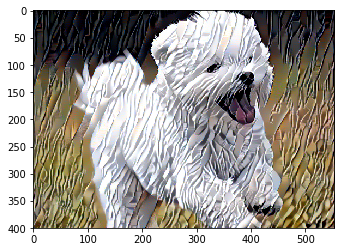

Step ... 1021
Step ... 1022
Step ... 1023
Step ... 1024
Step ... 1025
Step ... 1026
Step ... 1027
Step ... 1028
Step ... 1029
Step ... 1030
Step ... 1031
Step ... 1032
Step ... 1033
Step ... 1034
Step ... 1035
Step ... 1036
Step ... 1037
Step ... 1038
Step ... 1039
Step ... 1040
Step ... 1041
Step ... 1042
Step ... 1043
Step ... 1044
Step ... 1045
Step ... 1046
Step ... 1047
Step ... 1048
Step ... 1049
Step ... 1050
Total loss:  447353696.0


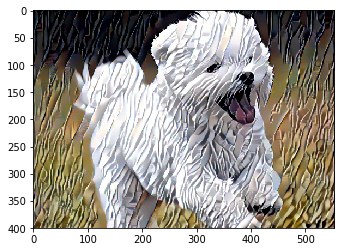

Step ... 1051
Step ... 1052
Step ... 1053
Step ... 1054
Step ... 1055
Step ... 1056
Step ... 1057
Step ... 1058
Step ... 1059
Step ... 1060
Step ... 1061
Step ... 1062
Step ... 1063
Step ... 1064
Step ... 1065
Step ... 1066
Step ... 1067
Step ... 1068
Step ... 1069
Step ... 1070
Step ... 1071
Step ... 1072
Step ... 1073
Step ... 1074
Step ... 1075
Step ... 1076
Step ... 1077
Step ... 1078
Step ... 1079
Step ... 1080
Total loss:  439045280.0


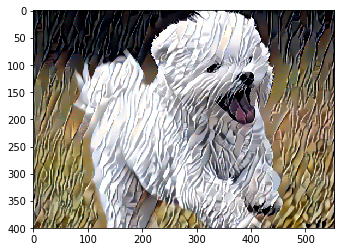

Step ... 1081
Step ... 1082
Step ... 1083
Step ... 1084
Step ... 1085
Step ... 1086
Step ... 1087
Step ... 1088
Step ... 1089
Step ... 1090
Step ... 1091
Step ... 1092
Step ... 1093
Step ... 1094
Step ... 1095
Step ... 1096
Step ... 1097
Step ... 1098
Step ... 1099
Step ... 1100
Step ... 1101
Step ... 1102
Step ... 1103
Step ... 1104
Step ... 1105
Step ... 1106
Step ... 1107
Step ... 1108
Step ... 1109
Step ... 1110
Total loss:  430987584.0


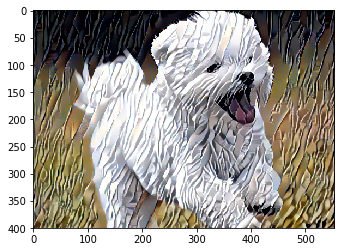

Step ... 1111
Step ... 1112
Step ... 1113
Step ... 1114
Step ... 1115
Step ... 1116
Step ... 1117
Step ... 1118
Step ... 1119
Step ... 1120
Step ... 1121
Step ... 1122
Step ... 1123
Step ... 1124
Step ... 1125
Step ... 1126
Step ... 1127
Step ... 1128
Step ... 1129
Step ... 1130
Step ... 1131
Step ... 1132
Step ... 1133
Step ... 1134
Step ... 1135
Step ... 1136
Step ... 1137
Step ... 1138
Step ... 1139
Step ... 1140
Total loss:  423151872.0


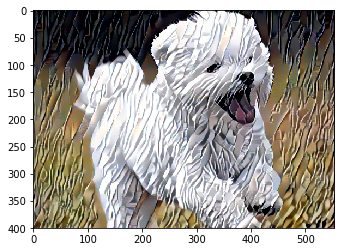

Step ... 1141
Step ... 1142
Step ... 1143
Step ... 1144
Step ... 1145
Step ... 1146
Step ... 1147
Step ... 1148
Step ... 1149
Step ... 1150
Step ... 1151
Step ... 1152
Step ... 1153
Step ... 1154
Step ... 1155
Step ... 1156
Step ... 1157
Step ... 1158
Step ... 1159
Step ... 1160
Step ... 1161
Step ... 1162
Step ... 1163
Step ... 1164
Step ... 1165
Step ... 1166
Step ... 1167
Step ... 1168
Step ... 1169
Step ... 1170
Total loss:  415558624.0


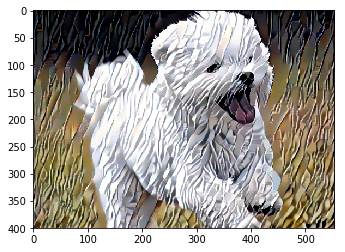

Step ... 1171
Step ... 1172
Step ... 1173
Step ... 1174
Step ... 1175
Step ... 1176
Step ... 1177
Step ... 1178
Step ... 1179
Step ... 1180
Step ... 1181
Step ... 1182
Step ... 1183
Step ... 1184
Step ... 1185
Step ... 1186
Step ... 1187
Step ... 1188
Step ... 1189
Step ... 1190
Step ... 1191
Step ... 1192
Step ... 1193
Step ... 1194
Step ... 1195
Step ... 1196
Step ... 1197
Step ... 1198
Step ... 1199
Step ... 1200
Total loss:  408167296.0


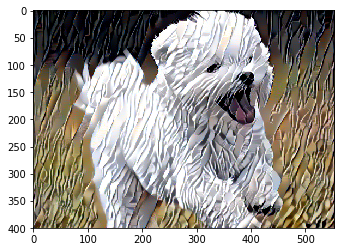

Step ... 1201
Step ... 1202
Step ... 1203
Step ... 1204
Step ... 1205
Step ... 1206
Step ... 1207
Step ... 1208
Step ... 1209
Step ... 1210
Step ... 1211
Step ... 1212
Step ... 1213
Step ... 1214
Step ... 1215
Step ... 1216
Step ... 1217
Step ... 1218
Step ... 1219
Step ... 1220
Step ... 1221
Step ... 1222
Step ... 1223
Step ... 1224
Step ... 1225
Step ... 1226
Step ... 1227
Step ... 1228
Step ... 1229
Step ... 1230
Total loss:  400952320.0


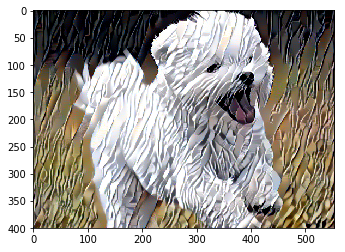

Step ... 1231
Step ... 1232
Step ... 1233
Step ... 1234
Step ... 1235
Step ... 1236
Step ... 1237
Step ... 1238
Step ... 1239
Step ... 1240
Step ... 1241
Step ... 1242
Step ... 1243
Step ... 1244
Step ... 1245
Step ... 1246
Step ... 1247
Step ... 1248
Step ... 1249
Step ... 1250
Step ... 1251
Step ... 1252
Step ... 1253
Step ... 1254
Step ... 1255
Step ... 1256
Step ... 1257
Step ... 1258
Step ... 1259
Step ... 1260
Total loss:  393895264.0


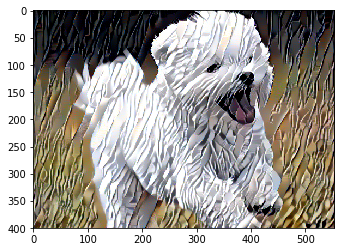

Step ... 1261
Step ... 1262
Step ... 1263
Step ... 1264
Step ... 1265
Step ... 1266
Step ... 1267
Step ... 1268
Step ... 1269
Step ... 1270
Step ... 1271
Step ... 1272
Step ... 1273
Step ... 1274
Step ... 1275
Step ... 1276
Step ... 1277
Step ... 1278
Step ... 1279
Step ... 1280
Step ... 1281
Step ... 1282
Step ... 1283
Step ... 1284
Step ... 1285
Step ... 1286
Step ... 1287
Step ... 1288
Step ... 1289
Step ... 1290
Total loss:  386990976.0


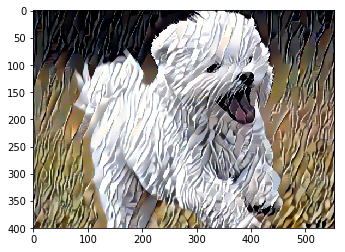

Step ... 1291
Step ... 1292
Step ... 1293
Step ... 1294
Step ... 1295
Step ... 1296
Step ... 1297
Step ... 1298
Step ... 1299
Step ... 1300
Step ... 1301
Step ... 1302
Step ... 1303
Step ... 1304
Step ... 1305
Step ... 1306
Step ... 1307
Step ... 1308
Step ... 1309
Step ... 1310
Step ... 1311
Step ... 1312
Step ... 1313
Step ... 1314
Step ... 1315
Step ... 1316
Step ... 1317
Step ... 1318
Step ... 1319
Step ... 1320
Total loss:  380226112.0


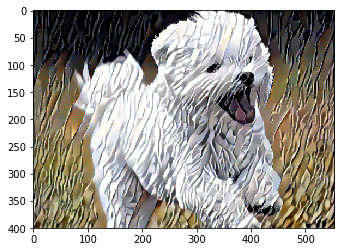

Step ... 1321
Step ... 1322
Step ... 1323
Step ... 1324
Step ... 1325
Step ... 1326
Step ... 1327
Step ... 1328
Step ... 1329
Step ... 1330
Step ... 1331
Step ... 1332
Step ... 1333
Step ... 1334
Step ... 1335
Step ... 1336
Step ... 1337
Step ... 1338
Step ... 1339
Step ... 1340
Step ... 1341
Step ... 1342
Step ... 1343
Step ... 1344
Step ... 1345
Step ... 1346
Step ... 1347
Step ... 1348
Step ... 1349
Step ... 1350
Total loss:  373628128.0


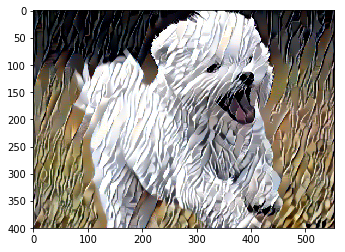

Step ... 1351
Step ... 1352
Step ... 1353
Step ... 1354
Step ... 1355
Step ... 1356
Step ... 1357
Step ... 1358
Step ... 1359
Step ... 1360
Step ... 1361
Step ... 1362
Step ... 1363
Step ... 1364
Step ... 1365
Step ... 1366
Step ... 1367
Step ... 1368
Step ... 1369
Step ... 1370
Step ... 1371
Step ... 1372
Step ... 1373
Step ... 1374
Step ... 1375
Step ... 1376
Step ... 1377
Step ... 1378
Step ... 1379
Step ... 1380
Total loss:  367178816.0


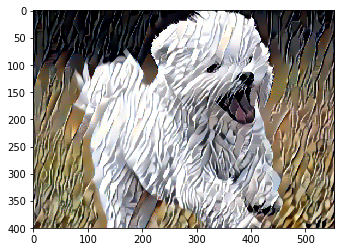

Step ... 1381
Step ... 1382
Step ... 1383
Step ... 1384
Step ... 1385
Step ... 1386
Step ... 1387
Step ... 1388
Step ... 1389
Step ... 1390
Step ... 1391
Step ... 1392
Step ... 1393
Step ... 1394
Step ... 1395
Step ... 1396
Step ... 1397
Step ... 1398
Step ... 1399
Step ... 1400
Step ... 1401
Step ... 1402
Step ... 1403
Step ... 1404
Step ... 1405
Step ... 1406
Step ... 1407
Step ... 1408
Step ... 1409
Step ... 1410
Total loss:  360903232.0


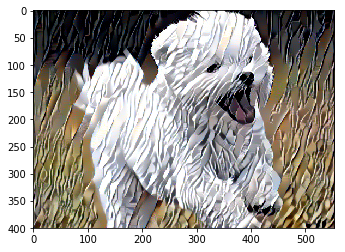

Step ... 1411
Step ... 1412
Step ... 1413
Step ... 1414
Step ... 1415
Step ... 1416
Step ... 1417
Step ... 1418
Step ... 1419
Step ... 1420
Step ... 1421
Step ... 1422
Step ... 1423
Step ... 1424
Step ... 1425
Step ... 1426
Step ... 1427
Step ... 1428
Step ... 1429
Step ... 1430
Step ... 1431
Step ... 1432
Step ... 1433
Step ... 1434
Step ... 1435
Step ... 1436
Step ... 1437
Step ... 1438
Step ... 1439
Step ... 1440
Total loss:  354808512.0


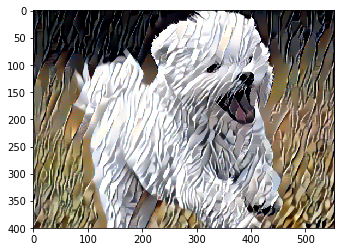

Step ... 1441
Step ... 1442
Step ... 1443
Step ... 1444
Step ... 1445
Step ... 1446
Step ... 1447
Step ... 1448
Step ... 1449
Step ... 1450
Step ... 1451
Step ... 1452
Step ... 1453
Step ... 1454
Step ... 1455
Step ... 1456
Step ... 1457
Step ... 1458
Step ... 1459
Step ... 1460
Step ... 1461
Step ... 1462
Step ... 1463
Step ... 1464
Step ... 1465
Step ... 1466
Step ... 1467
Step ... 1468
Step ... 1469
Step ... 1470
Total loss:  348830848.0


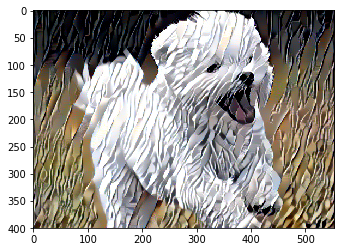

Step ... 1471
Step ... 1472
Step ... 1473
Step ... 1474
Step ... 1475
Step ... 1476
Step ... 1477
Step ... 1478
Step ... 1479
Step ... 1480
Step ... 1481
Step ... 1482
Step ... 1483
Step ... 1484
Step ... 1485
Step ... 1486
Step ... 1487
Step ... 1488
Step ... 1489
Step ... 1490
Step ... 1491
Step ... 1492
Step ... 1493
Step ... 1494
Step ... 1495
Step ... 1496
Step ... 1497
Step ... 1498
Step ... 1499
Step ... 1500
Total loss:  342938848.0


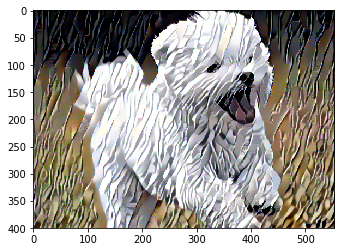

Step ... 1501
Step ... 1502
Step ... 1503
Step ... 1504
Step ... 1505
Step ... 1506
Step ... 1507
Step ... 1508
Step ... 1509
Step ... 1510
Step ... 1511
Step ... 1512
Step ... 1513
Step ... 1514
Step ... 1515
Step ... 1516
Step ... 1517
Step ... 1518
Step ... 1519
Step ... 1520
Step ... 1521
Step ... 1522
Step ... 1523
Step ... 1524
Step ... 1525
Step ... 1526
Step ... 1527
Step ... 1528
Step ... 1529
Step ... 1530
Total loss:  337170368.0


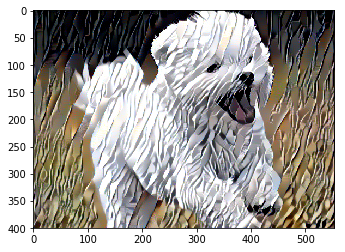

Step ... 1531
Step ... 1532
Step ... 1533
Step ... 1534
Step ... 1535
Step ... 1536
Step ... 1537
Step ... 1538
Step ... 1539
Step ... 1540
Step ... 1541
Step ... 1542
Step ... 1543
Step ... 1544
Step ... 1545
Step ... 1546
Step ... 1547
Step ... 1548
Step ... 1549
Step ... 1550
Step ... 1551
Step ... 1552
Step ... 1553
Step ... 1554
Step ... 1555
Step ... 1556
Step ... 1557
Step ... 1558
Step ... 1559
Step ... 1560
Total loss:  331551616.0


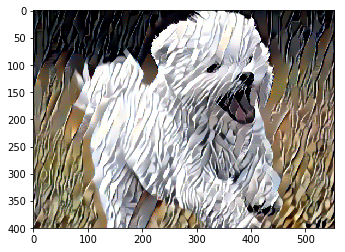

Step ... 1561
Step ... 1562
Step ... 1563
Step ... 1564
Step ... 1565
Step ... 1566
Step ... 1567
Step ... 1568
Step ... 1569
Step ... 1570
Step ... 1571
Step ... 1572
Step ... 1573
Step ... 1574
Step ... 1575
Step ... 1576
Step ... 1577
Step ... 1578
Step ... 1579
Step ... 1580
Step ... 1581
Step ... 1582
Step ... 1583
Step ... 1584
Step ... 1585
Step ... 1586
Step ... 1587
Step ... 1588
Step ... 1589
Step ... 1590
Total loss:  326073696.0


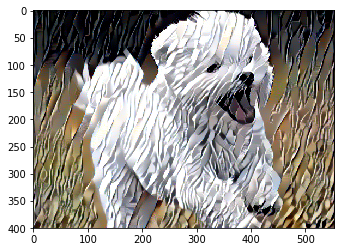

Step ... 1591
Step ... 1592
Step ... 1593
Step ... 1594
Step ... 1595
Step ... 1596
Step ... 1597
Step ... 1598
Step ... 1599
Step ... 1600
Step ... 1601
Step ... 1602
Step ... 1603
Step ... 1604
Step ... 1605
Step ... 1606
Step ... 1607
Step ... 1608
Step ... 1609
Step ... 1610
Step ... 1611
Step ... 1612
Step ... 1613
Step ... 1614
Step ... 1615
Step ... 1616
Step ... 1617
Step ... 1618
Step ... 1619
Step ... 1620
Total loss:  320694592.0


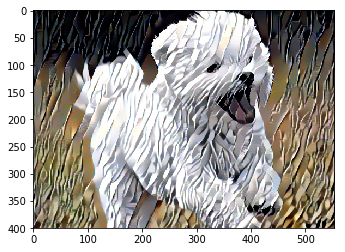

Step ... 1621
Step ... 1622
Step ... 1623
Step ... 1624
Step ... 1625
Step ... 1626
Step ... 1627
Step ... 1628
Step ... 1629
Step ... 1630
Step ... 1631
Step ... 1632
Step ... 1633
Step ... 1634
Step ... 1635
Step ... 1636
Step ... 1637
Step ... 1638
Step ... 1639
Step ... 1640
Step ... 1641
Step ... 1642
Step ... 1643
Step ... 1644
Step ... 1645
Step ... 1646
Step ... 1647
Step ... 1648
Step ... 1649
Step ... 1650
Total loss:  315437312.0


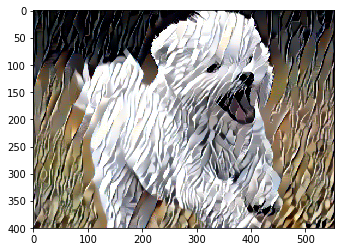

Step ... 1651
Step ... 1652
Step ... 1653
Step ... 1654
Step ... 1655
Step ... 1656
Step ... 1657
Step ... 1658
Step ... 1659
Step ... 1660
Step ... 1661
Step ... 1662
Step ... 1663
Step ... 1664
Step ... 1665
Step ... 1666
Step ... 1667
Step ... 1668
Step ... 1669
Step ... 1670
Step ... 1671
Step ... 1672
Step ... 1673
Step ... 1674
Step ... 1675
Step ... 1676
Step ... 1677
Step ... 1678
Step ... 1679
Step ... 1680
Total loss:  310322016.0


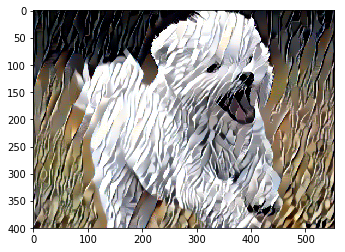

Step ... 1681
Step ... 1682
Step ... 1683
Step ... 1684
Step ... 1685
Step ... 1686
Step ... 1687
Step ... 1688
Step ... 1689
Step ... 1690
Step ... 1691
Step ... 1692
Step ... 1693
Step ... 1694
Step ... 1695
Step ... 1696
Step ... 1697
Step ... 1698
Step ... 1699
Step ... 1700
Step ... 1701
Step ... 1702
Step ... 1703
Step ... 1704
Step ... 1705
Step ... 1706
Step ... 1707
Step ... 1708
Step ... 1709
Step ... 1710
Total loss:  305311744.0


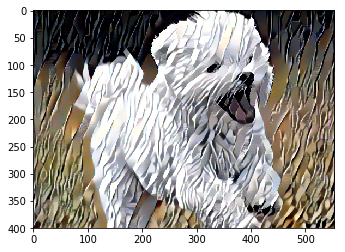

Step ... 1711
Step ... 1712
Step ... 1713
Step ... 1714
Step ... 1715
Step ... 1716
Step ... 1717
Step ... 1718
Step ... 1719
Step ... 1720
Step ... 1721
Step ... 1722
Step ... 1723
Step ... 1724
Step ... 1725
Step ... 1726
Step ... 1727
Step ... 1728
Step ... 1729
Step ... 1730
Step ... 1731
Step ... 1732
Step ... 1733
Step ... 1734
Step ... 1735
Step ... 1736
Step ... 1737
Step ... 1738
Step ... 1739
Step ... 1740
Total loss:  300424800.0


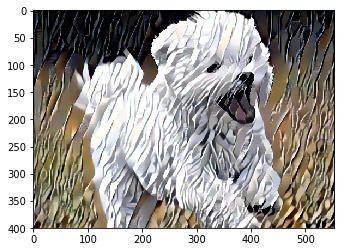

Step ... 1741
Step ... 1742
Step ... 1743
Step ... 1744
Step ... 1745
Step ... 1746
Step ... 1747
Step ... 1748
Step ... 1749
Step ... 1750
Step ... 1751
Step ... 1752
Step ... 1753
Step ... 1754
Step ... 1755
Step ... 1756
Step ... 1757
Step ... 1758
Step ... 1759
Step ... 1760
Step ... 1761
Step ... 1762
Step ... 1763
Step ... 1764
Step ... 1765
Step ... 1766
Step ... 1767
Step ... 1768
Step ... 1769
Step ... 1770
Total loss:  295642656.0


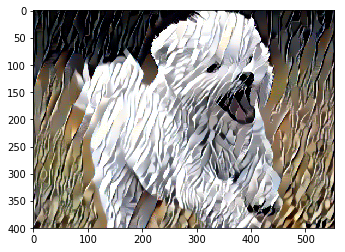

Step ... 1771
Step ... 1772
Step ... 1773
Step ... 1774
Step ... 1775
Step ... 1776
Step ... 1777
Step ... 1778
Step ... 1779
Step ... 1780
Step ... 1781
Step ... 1782
Step ... 1783
Step ... 1784
Step ... 1785
Step ... 1786
Step ... 1787
Step ... 1788
Step ... 1789
Step ... 1790
Step ... 1791
Step ... 1792
Step ... 1793
Step ... 1794
Step ... 1795
Step ... 1796
Step ... 1797
Step ... 1798
Step ... 1799
Step ... 1800
Total loss:  290950688.0


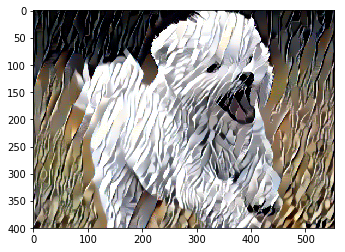

Step ... 1801
Step ... 1802
Step ... 1803
Step ... 1804
Step ... 1805
Step ... 1806
Step ... 1807
Step ... 1808
Step ... 1809
Step ... 1810
Step ... 1811
Step ... 1812
Step ... 1813
Step ... 1814
Step ... 1815
Step ... 1816
Step ... 1817
Step ... 1818
Step ... 1819
Step ... 1820
Step ... 1821
Step ... 1822
Step ... 1823
Step ... 1824
Step ... 1825
Step ... 1826
Step ... 1827
Step ... 1828
Step ... 1829
Step ... 1830
Total loss:  286360832.0


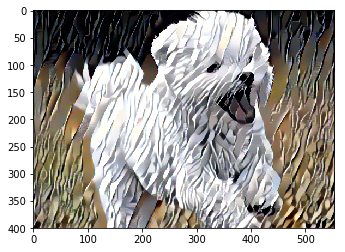

Step ... 1831
Step ... 1832
Step ... 1833
Step ... 1834
Step ... 1835
Step ... 1836
Step ... 1837
Step ... 1838
Step ... 1839
Step ... 1840
Step ... 1841
Step ... 1842
Step ... 1843
Step ... 1844
Step ... 1845
Step ... 1846
Step ... 1847
Step ... 1848
Step ... 1849
Step ... 1850
Step ... 1851
Step ... 1852
Step ... 1853
Step ... 1854
Step ... 1855
Step ... 1856
Step ... 1857
Step ... 1858
Step ... 1859
Step ... 1860
Total loss:  281870304.0


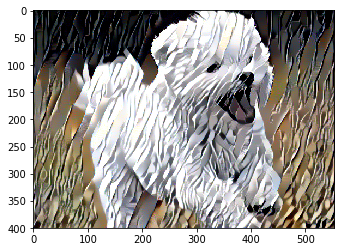

Step ... 1861
Step ... 1862
Step ... 1863
Step ... 1864
Step ... 1865
Step ... 1866
Step ... 1867
Step ... 1868
Step ... 1869
Step ... 1870
Step ... 1871
Step ... 1872
Step ... 1873
Step ... 1874
Step ... 1875
Step ... 1876
Step ... 1877
Step ... 1878
Step ... 1879
Step ... 1880
Step ... 1881
Step ... 1882
Step ... 1883
Step ... 1884
Step ... 1885
Step ... 1886
Step ... 1887
Step ... 1888
Step ... 1889
Step ... 1890
Total loss:  277429888.0


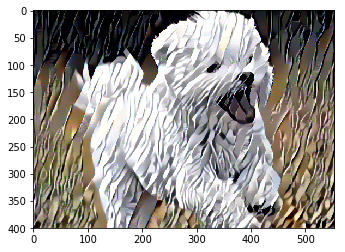

Step ... 1891
Step ... 1892
Step ... 1893
Step ... 1894
Step ... 1895
Step ... 1896
Step ... 1897
Step ... 1898
Step ... 1899
Step ... 1900
Step ... 1901
Step ... 1902
Step ... 1903
Step ... 1904
Step ... 1905
Step ... 1906
Step ... 1907
Step ... 1908
Step ... 1909
Step ... 1910
Step ... 1911
Step ... 1912
Step ... 1913
Step ... 1914
Step ... 1915
Step ... 1916
Step ... 1917
Step ... 1918
Step ... 1919
Step ... 1920
Total loss:  273056192.0


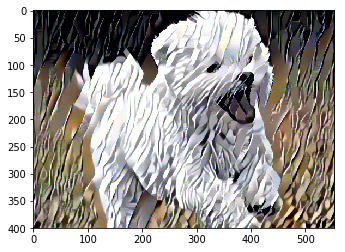

Step ... 1921
Step ... 1922
Step ... 1923
Step ... 1924
Step ... 1925
Step ... 1926
Step ... 1927
Step ... 1928
Step ... 1929
Step ... 1930
Step ... 1931
Step ... 1932
Step ... 1933
Step ... 1934
Step ... 1935
Step ... 1936
Step ... 1937
Step ... 1938
Step ... 1939
Step ... 1940
Step ... 1941
Step ... 1942
Step ... 1943
Step ... 1944
Step ... 1945
Step ... 1946
Step ... 1947
Step ... 1948
Step ... 1949
Step ... 1950
Total loss:  268763264.0


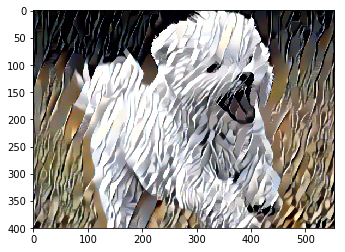

Step ... 1951
Step ... 1952
Step ... 1953
Step ... 1954
Step ... 1955
Step ... 1956
Step ... 1957
Step ... 1958
Step ... 1959
Step ... 1960
Step ... 1961
Step ... 1962
Step ... 1963
Step ... 1964
Step ... 1965
Step ... 1966
Step ... 1967
Step ... 1968
Step ... 1969
Step ... 1970
Step ... 1971
Step ... 1972
Step ... 1973
Step ... 1974
Step ... 1975
Step ... 1976
Step ... 1977
Step ... 1978
Step ... 1979
Step ... 1980
Total loss:  264539040.0


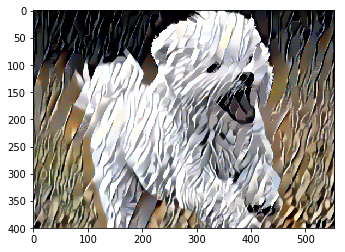

Step ... 1981
Step ... 1982
Step ... 1983
Step ... 1984
Step ... 1985
Step ... 1986
Step ... 1987
Step ... 1988
Step ... 1989
Step ... 1990
Step ... 1991
Step ... 1992
Step ... 1993
Step ... 1994
Step ... 1995
Step ... 1996
Step ... 1997
Step ... 1998
Step ... 1999
Step ... 2000
Step ... 2001
Step ... 2002
Step ... 2003
Step ... 2004
Step ... 2005
Step ... 2006
Step ... 2007
Step ... 2008
Step ... 2009
Step ... 2010
Total loss:  260400992.0


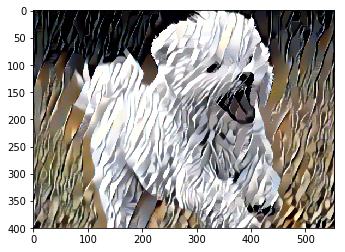

Step ... 2011
Step ... 2012
Step ... 2013
Step ... 2014
Step ... 2015
Step ... 2016
Step ... 2017
Step ... 2018
Step ... 2019
Step ... 2020
Step ... 2021
Step ... 2022
Step ... 2023
Step ... 2024
Step ... 2025
Step ... 2026
Step ... 2027
Step ... 2028
Step ... 2029
Step ... 2030
Step ... 2031
Step ... 2032
Step ... 2033
Step ... 2034
Step ... 2035
Step ... 2036
Step ... 2037
Step ... 2038
Step ... 2039
Step ... 2040
Total loss:  256340352.0


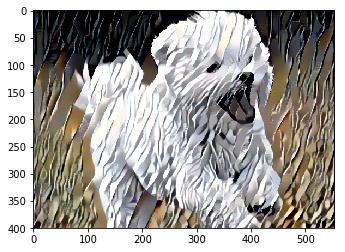

Step ... 2041
Step ... 2042
Step ... 2043
Step ... 2044
Step ... 2045
Step ... 2046
Step ... 2047
Step ... 2048
Step ... 2049
Step ... 2050
Step ... 2051
Step ... 2052
Step ... 2053
Step ... 2054
Step ... 2055
Step ... 2056
Step ... 2057
Step ... 2058
Step ... 2059
Step ... 2060
Step ... 2061
Step ... 2062
Step ... 2063
Step ... 2064
Step ... 2065
Step ... 2066
Step ... 2067
Step ... 2068
Step ... 2069
Step ... 2070
Total loss:  252354048.0


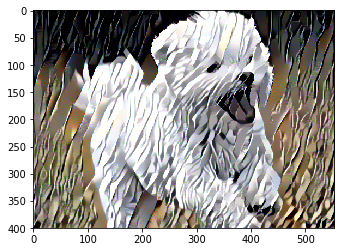

Step ... 2071
Step ... 2072
Step ... 2073
Step ... 2074
Step ... 2075
Step ... 2076
Step ... 2077
Step ... 2078
Step ... 2079
Step ... 2080
Step ... 2081
Step ... 2082
Step ... 2083
Step ... 2084
Step ... 2085
Step ... 2086
Step ... 2087
Step ... 2088
Step ... 2089
Step ... 2090
Step ... 2091
Step ... 2092
Step ... 2093
Step ... 2094
Step ... 2095
Step ... 2096
Step ... 2097
Step ... 2098
Step ... 2099
Step ... 2100
Total loss:  248456336.0


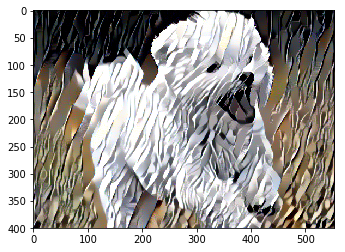

Step ... 2101
Step ... 2102
Step ... 2103
Step ... 2104
Step ... 2105
Step ... 2106
Step ... 2107
Step ... 2108
Step ... 2109
Step ... 2110
Step ... 2111
Step ... 2112
Step ... 2113
Step ... 2114
Step ... 2115
Step ... 2116
Step ... 2117
Step ... 2118
Step ... 2119
Step ... 2120
Step ... 2121
Step ... 2122
Step ... 2123
Step ... 2124
Step ... 2125
Step ... 2126
Step ... 2127
Step ... 2128
Step ... 2129
Step ... 2130
Total loss:  244609360.0


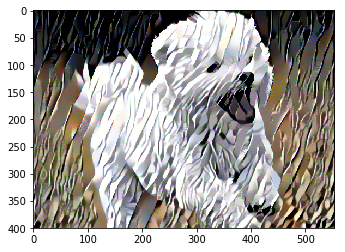

Step ... 2131
Step ... 2132
Step ... 2133
Step ... 2134
Step ... 2135
Step ... 2136
Step ... 2137
Step ... 2138
Step ... 2139
Step ... 2140
Step ... 2141
Step ... 2142
Step ... 2143
Step ... 2144
Step ... 2145
Step ... 2146
Step ... 2147
Step ... 2148
Step ... 2149
Step ... 2150
Step ... 2151
Step ... 2152
Step ... 2153
Step ... 2154
Step ... 2155
Step ... 2156
Step ... 2157
Step ... 2158
Step ... 2159
Step ... 2160
Total loss:  240843536.0


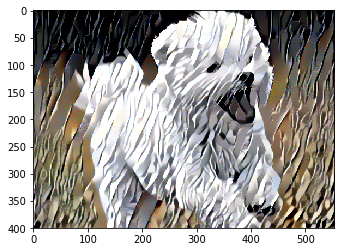

Step ... 2161
Step ... 2162
Step ... 2163
Step ... 2164
Step ... 2165
Step ... 2166
Step ... 2167
Step ... 2168
Step ... 2169
Step ... 2170
Step ... 2171
Step ... 2172
Step ... 2173
Step ... 2174
Step ... 2175
Step ... 2176
Step ... 2177
Step ... 2178
Step ... 2179
Step ... 2180
Step ... 2181
Step ... 2182
Step ... 2183
Step ... 2184
Step ... 2185
Step ... 2186
Step ... 2187
Step ... 2188
Step ... 2189
Step ... 2190
Total loss:  237156944.0


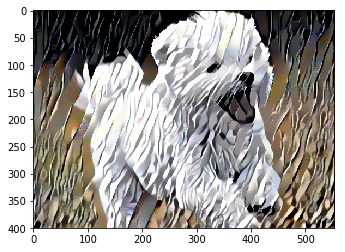

Step ... 2191
Step ... 2192
Step ... 2193
Step ... 2194
Step ... 2195
Step ... 2196
Step ... 2197
Step ... 2198
Step ... 2199
Step ... 2200
Step ... 2201
Step ... 2202
Step ... 2203
Step ... 2204
Step ... 2205
Step ... 2206
Step ... 2207
Step ... 2208
Step ... 2209
Step ... 2210
Step ... 2211
Step ... 2212
Step ... 2213
Step ... 2214
Step ... 2215
Step ... 2216
Step ... 2217
Step ... 2218
Step ... 2219
Step ... 2220
Total loss:  233548048.0


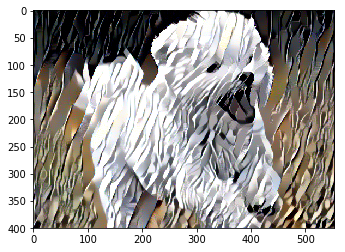

Step ... 2221
Step ... 2222
Step ... 2223
Step ... 2224
Step ... 2225
Step ... 2226
Step ... 2227
Step ... 2228
Step ... 2229
Step ... 2230
Step ... 2231
Step ... 2232
Step ... 2233
Step ... 2234
Step ... 2235
Step ... 2236
Step ... 2237
Step ... 2238
Step ... 2239
Step ... 2240
Step ... 2241
Step ... 2242
Step ... 2243
Step ... 2244
Step ... 2245
Step ... 2246
Step ... 2247
Step ... 2248
Step ... 2249
Step ... 2250
Total loss:  230000688.0


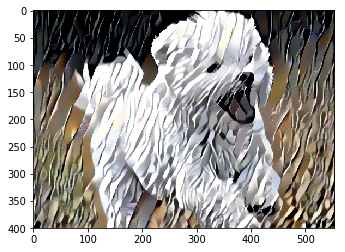

Step ... 2251
Step ... 2252
Step ... 2253
Step ... 2254
Step ... 2255
Step ... 2256
Step ... 2257
Step ... 2258
Step ... 2259
Step ... 2260
Step ... 2261
Step ... 2262
Step ... 2263
Step ... 2264
Step ... 2265
Step ... 2266
Step ... 2267
Step ... 2268
Step ... 2269
Step ... 2270
Step ... 2271
Step ... 2272
Step ... 2273
Step ... 2274
Step ... 2275
Step ... 2276
Step ... 2277
Step ... 2278
Step ... 2279
Step ... 2280
Total loss:  226548784.0


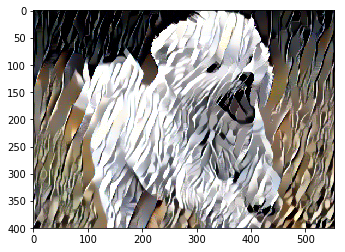

Step ... 2281
Step ... 2282
Step ... 2283
Step ... 2284
Step ... 2285
Step ... 2286
Step ... 2287
Step ... 2288
Step ... 2289
Step ... 2290
Step ... 2291
Step ... 2292
Step ... 2293
Step ... 2294
Step ... 2295
Step ... 2296
Step ... 2297
Step ... 2298
Step ... 2299
Step ... 2300
Step ... 2301
Step ... 2302
Step ... 2303
Step ... 2304
Step ... 2305
Step ... 2306
Step ... 2307
Step ... 2308
Step ... 2309
Step ... 2310
Total loss:  223171072.0


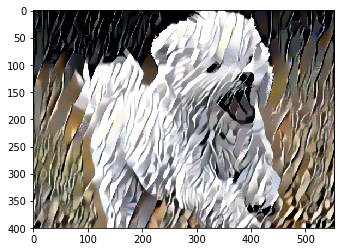

Step ... 2311
Step ... 2312
Step ... 2313
Step ... 2314
Step ... 2315
Step ... 2316
Step ... 2317
Step ... 2318
Step ... 2319
Step ... 2320
Step ... 2321
Step ... 2322
Step ... 2323
Step ... 2324
Step ... 2325
Step ... 2326
Step ... 2327
Step ... 2328
Step ... 2329
Step ... 2330
Step ... 2331
Step ... 2332
Step ... 2333
Step ... 2334
Step ... 2335
Step ... 2336
Step ... 2337
Step ... 2338
Step ... 2339
Step ... 2340
Total loss:  219872480.0


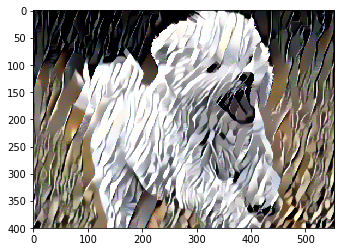

Step ... 2341
Step ... 2342
Step ... 2343
Step ... 2344
Step ... 2345
Step ... 2346
Step ... 2347
Step ... 2348
Step ... 2349
Step ... 2350
Step ... 2351
Step ... 2352
Step ... 2353
Step ... 2354
Step ... 2355
Step ... 2356
Step ... 2357
Step ... 2358
Step ... 2359
Step ... 2360
Step ... 2361
Step ... 2362
Step ... 2363
Step ... 2364
Step ... 2365
Step ... 2366
Step ... 2367
Step ... 2368
Step ... 2369
Step ... 2370
Total loss:  216639504.0


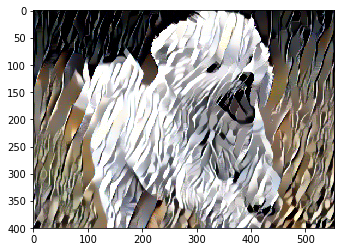

Step ... 2371
Step ... 2372
Step ... 2373
Step ... 2374
Step ... 2375
Step ... 2376
Step ... 2377
Step ... 2378
Step ... 2379
Step ... 2380
Step ... 2381
Step ... 2382
Step ... 2383
Step ... 2384
Step ... 2385
Step ... 2386
Step ... 2387
Step ... 2388
Step ... 2389
Step ... 2390
Step ... 2391
Step ... 2392
Step ... 2393
Step ... 2394
Step ... 2395
Step ... 2396
Step ... 2397
Step ... 2398
Step ... 2399
Step ... 2400
Total loss:  213476832.0


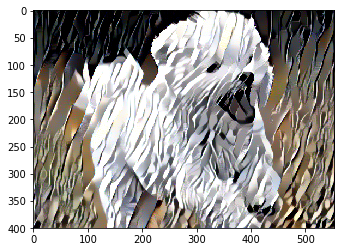

Step ... 2401
Step ... 2402
Step ... 2403
Step ... 2404
Step ... 2405
Step ... 2406
Step ... 2407
Step ... 2408
Step ... 2409
Step ... 2410
Step ... 2411
Step ... 2412
Step ... 2413
Step ... 2414
Step ... 2415
Step ... 2416
Step ... 2417
Step ... 2418
Step ... 2419
Step ... 2420
Step ... 2421
Step ... 2422
Step ... 2423
Step ... 2424
Step ... 2425
Step ... 2426
Step ... 2427
Step ... 2428
Step ... 2429
Step ... 2430
Total loss:  210373232.0


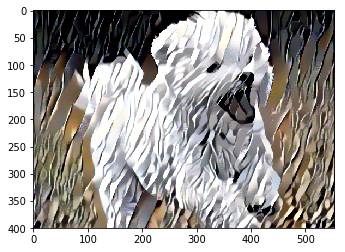

Step ... 2431
Step ... 2432
Step ... 2433
Step ... 2434
Step ... 2435
Step ... 2436
Step ... 2437
Step ... 2438
Step ... 2439
Step ... 2440
Step ... 2441
Step ... 2442
Step ... 2443
Step ... 2444
Step ... 2445
Step ... 2446
Step ... 2447
Step ... 2448
Step ... 2449
Step ... 2450
Step ... 2451
Step ... 2452
Step ... 2453
Step ... 2454
Step ... 2455
Step ... 2456
Step ... 2457
Step ... 2458
Step ... 2459
Step ... 2460
Total loss:  207316656.0


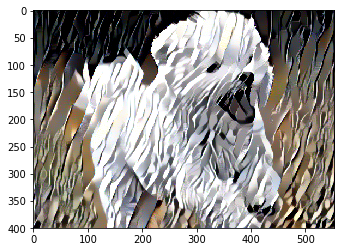

Step ... 2461
Step ... 2462
Step ... 2463
Step ... 2464
Step ... 2465
Step ... 2466
Step ... 2467
Step ... 2468
Step ... 2469
Step ... 2470
Step ... 2471
Step ... 2472
Step ... 2473
Step ... 2474
Step ... 2475
Step ... 2476
Step ... 2477
Step ... 2478
Step ... 2479
Step ... 2480
Step ... 2481
Step ... 2482
Step ... 2483
Step ... 2484
Step ... 2485
Step ... 2486
Step ... 2487
Step ... 2488
Step ... 2489
Step ... 2490
Total loss:  204307328.0


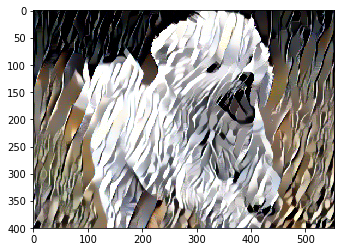

Step ... 2491
Step ... 2492
Step ... 2493
Step ... 2494
Step ... 2495
Step ... 2496
Step ... 2497
Step ... 2498
Step ... 2499
Step ... 2500
Step ... 2501
Step ... 2502
Step ... 2503
Step ... 2504
Step ... 2505
Step ... 2506
Step ... 2507
Step ... 2508
Step ... 2509
Step ... 2510
Step ... 2511
Step ... 2512
Step ... 2513
Step ... 2514
Step ... 2515
Step ... 2516
Step ... 2517
Step ... 2518
Step ... 2519
Step ... 2520
Total loss:  201357248.0


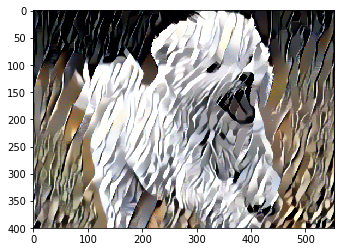

Step ... 2521
Step ... 2522
Step ... 2523
Step ... 2524
Step ... 2525
Step ... 2526
Step ... 2527
Step ... 2528
Step ... 2529
Step ... 2530
Step ... 2531
Step ... 2532
Step ... 2533
Step ... 2534
Step ... 2535
Step ... 2536
Step ... 2537
Step ... 2538
Step ... 2539
Step ... 2540
Step ... 2541
Step ... 2542
Step ... 2543
Step ... 2544
Step ... 2545
Step ... 2546
Step ... 2547
Step ... 2548
Step ... 2549
Step ... 2550
Total loss:  198440464.0


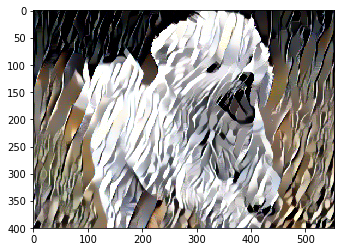

Step ... 2551
Step ... 2552
Step ... 2553
Step ... 2554
Step ... 2555
Step ... 2556
Step ... 2557
Step ... 2558
Step ... 2559
Step ... 2560
Step ... 2561
Step ... 2562
Step ... 2563
Step ... 2564
Step ... 2565
Step ... 2566
Step ... 2567
Step ... 2568
Step ... 2569
Step ... 2570
Step ... 2571
Step ... 2572
Step ... 2573
Step ... 2574
Step ... 2575
Step ... 2576
Step ... 2577
Step ... 2578
Step ... 2579
Step ... 2580
Total loss:  195573328.0


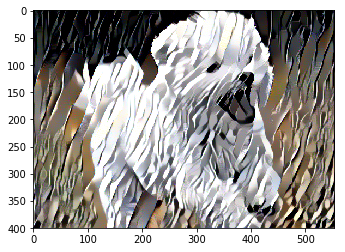

Step ... 2581
Step ... 2582
Step ... 2583
Step ... 2584
Step ... 2585
Step ... 2586
Step ... 2587
Step ... 2588
Step ... 2589
Step ... 2590
Step ... 2591
Step ... 2592
Step ... 2593
Step ... 2594
Step ... 2595
Step ... 2596
Step ... 2597
Step ... 2598
Step ... 2599
Step ... 2600
Step ... 2601
Step ... 2602
Step ... 2603
Step ... 2604
Step ... 2605
Step ... 2606
Step ... 2607
Step ... 2608
Step ... 2609
Step ... 2610
Total loss:  192750000.0


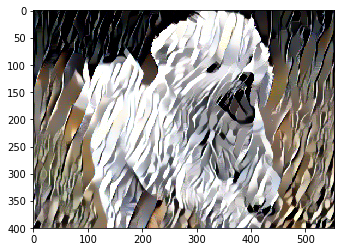

Step ... 2611
Step ... 2612
Step ... 2613
Step ... 2614
Step ... 2615
Step ... 2616
Step ... 2617
Step ... 2618
Step ... 2619
Step ... 2620
Step ... 2621
Step ... 2622
Step ... 2623
Step ... 2624
Step ... 2625
Step ... 2626
Step ... 2627
Step ... 2628
Step ... 2629
Step ... 2630
Step ... 2631
Step ... 2632
Step ... 2633
Step ... 2634
Step ... 2635
Step ... 2636
Step ... 2637
Step ... 2638
Step ... 2639
Step ... 2640
Total loss:  189970064.0


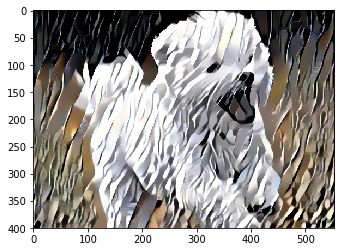

Step ... 2641
Step ... 2642
Step ... 2643
Step ... 2644
Step ... 2645
Step ... 2646
Step ... 2647
Step ... 2648
Step ... 2649
Step ... 2650
Step ... 2651
Step ... 2652
Step ... 2653
Step ... 2654
Step ... 2655
Step ... 2656
Step ... 2657
Step ... 2658
Step ... 2659
Step ... 2660
Step ... 2661
Step ... 2662
Step ... 2663
Step ... 2664
Step ... 2665
Step ... 2666
Step ... 2667
Step ... 2668
Step ... 2669
Step ... 2670
Total loss:  187250704.0


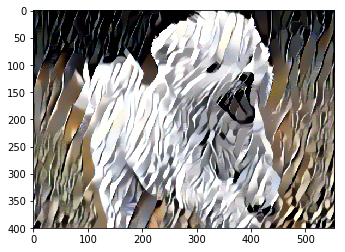

Step ... 2671
Step ... 2672
Step ... 2673
Step ... 2674
Step ... 2675
Step ... 2676
Step ... 2677
Step ... 2678
Step ... 2679
Step ... 2680
Step ... 2681
Step ... 2682
Step ... 2683
Step ... 2684
Step ... 2685
Step ... 2686
Step ... 2687
Step ... 2688
Step ... 2689
Step ... 2690
Step ... 2691
Step ... 2692
Step ... 2693
Step ... 2694
Step ... 2695
Step ... 2696
Step ... 2697
Step ... 2698
Step ... 2699
Step ... 2700
Total loss:  184578464.0


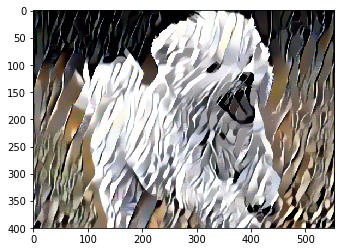

Step ... 2701
Step ... 2702


In [0]:
# for displaying the target image, intermittently
show_every = 30

# iteration hyperparameters
optimizer = optim.Adam([target], lr=0.003)
steps = 5000  # decide how many iterations to update your image (5000)

for ii in range(1, steps+1):
    
    print('Step ...',  ii)
    
    # get the features from your target image
    target_features = get_features(target, vgg)
    
    # the content loss
    content_loss = torch.mean((target_features['conv4_2'] - content_features['conv4_2'])**2)
    
    # the style loss
    # initialize the style loss to 0
    style_loss = 0
    # then add to it for each layer's gram matrix loss
    for layer in style_weights:
        # get the "target" style representation for the layer
        target_feature = target_features[layer]
        target_gram = gram_matrix(target_feature)
        _, d, h, w = target_feature.shape
        # get the "style" style representation
        style_gram = style_grams[layer]
        # the style loss for one layer, weighted appropriately
        layer_style_loss = style_weights[layer] * torch.mean((target_gram - style_gram)**2)
        # add to the style loss
        style_loss += layer_style_loss / (d * h * w)
        
    # calculate the *total* loss
    total_loss = content_weight * content_loss + style_weight * style_loss
    
    # update your target image
    optimizer.zero_grad()
    total_loss.backward()
    optimizer.step()
    
    # display intermediate images and print the loss
    if  ii % show_every == 0:
        print('Total loss: ', total_loss.item())
        plt.imshow(im_convert(target))
        plt.show()